# TLC Trip Record Data Prediction
---

---
## Import packages 

In [1]:
import pandas as pd
import numpy as np
import sklearn
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn.pipeline import Pipeline
%config InlineBackend.figure_format = 'svg'
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
import warnings
warnings.filterwarnings('ignore')
import random
from sklearn.linear_model import LinearRegression, Lasso, Ridge, RidgeCV
from yellowbrick.regressor import prediction_error

In [2]:
df1= pd.read_csv('green_tripdata-one-.csv')
df1

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
0,2.0,2021-01-01 00:15:56,2021-01-01 00:19:52,N,1.0,43,151,1.0,1.01,5.50,0.5,0.5,0.00,0.00,NaN,0.3,6.80,2.0,1.0,0.00
1,2.0,2021-01-01 00:25:59,2021-01-01 00:34:44,N,1.0,166,239,1.0,2.53,10.00,0.5,0.5,2.81,0.00,NaN,0.3,16.86,1.0,1.0,2.75
2,2.0,2021-01-01 00:45:57,2021-01-01 00:51:55,N,1.0,41,42,1.0,1.12,6.00,0.5,0.5,1.00,0.00,NaN,0.3,8.30,1.0,1.0,0.00
3,2.0,2020-12-31 23:57:51,2021-01-01 00:04:56,N,1.0,168,75,1.0,1.99,8.00,0.5,0.5,0.00,0.00,NaN,0.3,9.30,2.0,1.0,0.00
4,2.0,2021-01-01 00:16:36,2021-01-01 00:16:40,N,2.0,265,265,3.0,0.00,-52.00,0.0,-0.5,0.00,0.00,NaN,-0.3,-52.80,3.0,1.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76513,NaN,2021-01-15 10:35:00,2021-01-15 10:51:00,NaN,NaN,3,147,NaN,5.97,17.01,0.0,0.0,0.00,0.00,NaN,0.3,17.31,NaN,NaN,NaN
76514,NaN,2021-01-15 10:25:00,2021-01-15 10:34:00,NaN,NaN,242,213,NaN,3.83,27.27,0.0,0.0,2.75,0.00,NaN,0.3,30.32,NaN,NaN,NaN
76515,NaN,2021-01-15 10:16:00,2021-01-15 10:20:00,NaN,NaN,181,181,NaN,0.45,12.89,0.0,0.0,2.75,0.00,NaN,0.3,15.94,NaN,NaN,NaN
76516,NaN,2021-01-15 10:16:00,2021-01-15 10:58:00,NaN,NaN,244,72,NaN,22.21,50.67,0.0,0.0,2.75,6.12,NaN,0.3,59.84,NaN,NaN,NaN


In [3]:
df2= pd.read_csv('green_tripdata_two-.csv')
df2

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
0,2.0,2021-02-01 00:34:03,2021-02-01 00:51:58,N,1.0,130,205,5.0,3.66,14.00,0.50,0.5,10.00,0.0,NaN,0.3,25.30,1.0,1.0,0.00
1,2.0,2021-02-01 00:04:00,2021-02-01 00:10:30,N,1.0,152,244,1.0,1.10,6.50,0.50,0.5,0.00,0.0,NaN,0.3,7.80,2.0,1.0,0.00
2,2.0,2021-02-01 00:18:51,2021-02-01 00:34:06,N,1.0,152,48,1.0,4.93,16.50,0.50,0.5,0.00,0.0,NaN,0.3,20.55,2.0,1.0,2.75
3,2.0,2021-02-01 00:53:27,2021-02-01 01:11:41,N,1.0,152,241,1.0,6.70,21.00,0.50,0.5,0.00,0.0,NaN,0.3,22.30,2.0,1.0,0.00
4,2.0,2021-02-01 00:57:46,2021-02-01 01:06:44,N,1.0,75,42,1.0,1.89,8.50,0.50,0.5,2.45,0.0,NaN,0.3,12.25,1.0,1.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
64567,NaN,2021-02-26 08:46:00,2021-02-26 08:59:00,NaN,NaN,167,247,NaN,1.47,14.55,2.75,0.0,0.00,0.0,NaN,0.3,17.60,NaN,NaN,NaN
64568,NaN,2021-02-26 08:56:00,2021-02-26 09:10:00,NaN,NaN,89,123,NaN,2.87,20.22,2.75,0.0,0.00,0.0,NaN,0.3,23.27,NaN,NaN,NaN
64569,NaN,2021-02-26 08:46:00,2021-02-26 09:07:00,NaN,NaN,127,166,NaN,4.74,24.94,5.50,0.0,0.00,0.0,NaN,0.3,30.74,NaN,NaN,NaN
64570,NaN,2021-02-26 08:17:00,2021-02-26 08:51:00,NaN,NaN,42,137,NaN,7.63,41.81,2.75,0.0,0.00,0.0,NaN,0.3,44.86,NaN,NaN,NaN


In [4]:
con_data= pd.concat([df1,df2])   # concat two dataset
con_data.head(10)

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
0,2.0,2021-01-01 00:15:56,2021-01-01 00:19:52,N,1.0,43,151,1.0,1.01,5.5,0.5,0.5,0.00,0.0,NaN,0.3,6.80,2.0,1.0,0.00
1,2.0,2021-01-01 00:25:59,2021-01-01 00:34:44,N,1.0,166,239,1.0,2.53,10.0,0.5,0.5,2.81,0.0,NaN,0.3,16.86,1.0,1.0,2.75
2,2.0,2021-01-01 00:45:57,2021-01-01 00:51:55,N,1.0,41,42,1.0,1.12,6.0,0.5,0.5,1.00,0.0,NaN,0.3,8.30,1.0,1.0,0.00
3,2.0,2020-12-31 23:57:51,2021-01-01 00:04:56,N,1.0,168,75,1.0,1.99,8.0,0.5,0.5,0.00,0.0,NaN,0.3,9.30,2.0,1.0,0.00
4,2.0,2021-01-01 00:16:36,2021-01-01 00:16:40,N,2.0,265,265,3.0,0.00,-52.0,0.0,-0.5,0.00,0.0,NaN,-0.3,-52.80,3.0,1.0,0.00
5,2.0,2021-01-01 00:16:36,2021-01-01 00:16:40,N,2.0,265,265,3.0,0.00,52.0,0.0,0.5,0.00,0.0,NaN,0.3,52.80,2.0,1.0,0.00
6,2.0,2021-01-01 00:19:14,2021-01-01 00:19:21,N,5.0,265,265,1.0,0.00,180.0,0.0,0.0,36.06,0.0,NaN,0.3,216.36,1.0,2.0,0.00
7,2.0,2021-01-01 00:26:31,2021-01-01 00:28:50,N,1.0,75,75,6.0,0.45,3.5,0.5,0.5,0.96,0.0,NaN,0.3,5.76,1.0,1.0,0.00
8,2.0,2021-01-01 00:57:46,2021-01-01 00:57:57,N,1.0,225,225,1.0,0.00,2.5,0.5,0.5,0.00,0.0,NaN,0.3,3.80,2.0,1.0,0.00
9,2.0,2021-01-01 00:58:32,2021-01-01 01:32:34,N,1.0,225,265,1.0,12.19,38.0,0.5,0.5,2.75,0.0,NaN,0.3,42.05,1.0,1.0,0.00


In [5]:
con_data= con_data.reset_index(drop= True)

In [6]:
con_data.shape

(141090, 20)

In [7]:
con_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 141090 entries, 0 to 141089
Data columns (total 20 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   VendorID               75934 non-null   float64
 1   lpep_pickup_datetime   141090 non-null  object 
 2   lpep_dropoff_datetime  141090 non-null  object 
 3   store_and_fwd_flag     75934 non-null   object 
 4   RatecodeID             75934 non-null   float64
 5   PULocationID           141090 non-null  int64  
 6   DOLocationID           141090 non-null  int64  
 7   passenger_count        75934 non-null   float64
 8   trip_distance          141090 non-null  float64
 9   fare_amount            141090 non-null  float64
 10  extra                  141090 non-null  float64
 11  mta_tax                141090 non-null  float64
 12  tip_amount             141090 non-null  float64
 13  tolls_amount           141090 non-null  float64
 14  ehail_fee              0 non-null   

In [8]:
duplicate = con_data.duplicated()
print(duplicate.sum())
con_data[duplicate]

0


,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge


In [9]:
duplicate = con_data.index.duplicated()
print(duplicate.sum())

0


In [10]:
# split the data for train and test
con_data_train , con_data_test = train_test_split(con_data, test_size=0.2, random_state=199)

In [11]:
# split the train for train and val
con_data_train2, con_data_val =  train_test_split(con_data_train, test_size=0.2, random_state=199)

---
## Feature Engineering on Time

In [12]:
# convert type pickup datetime for train
con_data_train2['lpep_pickup_datetime']= pd.to_datetime(con_data_train2['lpep_pickup_datetime'],format="%Y-%m-%d %H:%M:%S")

# convert type pickup datetime for val
con_data_val['lpep_pickup_datetime']= pd.to_datetime(con_data_val['lpep_pickup_datetime'],format="%Y-%m-%d %H:%M:%S")

# convert type pickup datetime for test
con_data_test['lpep_pickup_datetime']= pd.to_datetime(con_data_test['lpep_pickup_datetime'],format="%Y-%m-%d %H:%M:%S")

############################

# convert type dropoff datetime for train
con_data_train2['lpep_dropoff_datetime']= pd.to_datetime(con_data_train2['lpep_dropoff_datetime'],format="%Y-%m-%d %H:%M:%S")

# convert type dropoff datetime for val
con_data_val['lpep_dropoff_datetime']= pd.to_datetime(con_data_val['lpep_dropoff_datetime'],format="%Y-%m-%d %H:%M:%S")

# convert type dropoff datetime for test
con_data_test['lpep_dropoff_datetime']= pd.to_datetime(con_data_test['lpep_dropoff_datetime'],format="%Y-%m-%d %H:%M:%S") 

In [13]:
con_data_train2.dtypes

VendorID                        float64
lpep_pickup_datetime     datetime64[ns]
lpep_dropoff_datetime    datetime64[ns]
store_and_fwd_flag               object
RatecodeID                      float64
PULocationID                      int64
DOLocationID                      int64
passenger_count                 float64
trip_distance                   float64
fare_amount                     float64
extra                           float64
mta_tax                         float64
tip_amount                      float64
tolls_amount                    float64
ehail_fee                       float64
improvement_surcharge           float64
total_amount                    float64
payment_type                    float64
trip_type                       float64
congestion_surcharge            float64
dtype: object

In [14]:
con_data_val.dtypes

VendorID                        float64
lpep_pickup_datetime     datetime64[ns]
lpep_dropoff_datetime    datetime64[ns]
store_and_fwd_flag               object
RatecodeID                      float64
PULocationID                      int64
DOLocationID                      int64
passenger_count                 float64
trip_distance                   float64
fare_amount                     float64
extra                           float64
mta_tax                         float64
tip_amount                      float64
tolls_amount                    float64
ehail_fee                       float64
improvement_surcharge           float64
total_amount                    float64
payment_type                    float64
trip_type                       float64
congestion_surcharge            float64
dtype: object

In [15]:
con_data_test.dtypes

VendorID                        float64
lpep_pickup_datetime     datetime64[ns]
lpep_dropoff_datetime    datetime64[ns]
store_and_fwd_flag               object
RatecodeID                      float64
PULocationID                      int64
DOLocationID                      int64
passenger_count                 float64
trip_distance                   float64
fare_amount                     float64
extra                           float64
mta_tax                         float64
tip_amount                      float64
tolls_amount                    float64
ehail_fee                       float64
improvement_surcharge           float64
total_amount                    float64
payment_type                    float64
trip_type                       float64
congestion_surcharge            float64
dtype: object

In [16]:
#### Pickup datetime convert ####

# for train

#extract month
con_data_train2["month_pickup"] = pd.DatetimeIndex(con_data_train2["lpep_pickup_datetime"]).month

#extract week day 
con_data_train2["week_day_pickup"]= con_data_train2["lpep_pickup_datetime"].dt.weekday

#extract day 
con_data_train2["day_pickup"]= con_data_train2["lpep_pickup_datetime"].dt.day

#extract hour
con_data_train2["hour_pickup"]= con_data_train2["lpep_pickup_datetime"].dt.hour 

con_data_train2 =con_data_train2.sort_values(by = "lpep_pickup_datetime",ascending = True)

#####################

# for val

#extract month
con_data_val["month_pickup"] = pd.DatetimeIndex(con_data_val["lpep_pickup_datetime"]).month

#extract week day 
con_data_val["week_day_pickup"]= con_data_val["lpep_pickup_datetime"].dt.weekday

#extract day 
con_data_val["day_pickup"]= con_data_val["lpep_pickup_datetime"].dt.day

#extract hour
con_data_val["hour_pickup"]= con_data_val["lpep_pickup_datetime"].dt.hour 

con_data_val =con_data_val.sort_values(by = "lpep_pickup_datetime",ascending = True)

#####################

# for test

#extract month
con_data_test["month_pickup"] = pd.DatetimeIndex(con_data_test["lpep_pickup_datetime"]).month

#extract week day 
con_data_test["week_day_pickup"]= con_data_test["lpep_pickup_datetime"].dt.weekday

#extract day 
con_data_test["day_pickup"]= con_data_test["lpep_pickup_datetime"].dt.day

#extract hour
con_data_test["hour_pickup"]= con_data_test["lpep_pickup_datetime"].dt.hour 

con_data_test =con_data_test.sort_values(by = "lpep_pickup_datetime",ascending = True)

In [17]:
#### Dropoff datetime convert ####

# for train

#extract month
con_data_train2["month_dropoff"] = pd.DatetimeIndex(con_data_train2["lpep_dropoff_datetime"]).month

#extract week day 
con_data_train2["week_day_dropoff"]= con_data_train2["lpep_dropoff_datetime"].dt.weekday

#extract day 
con_data_train2["day_dropoff"]= con_data_train2["lpep_dropoff_datetime"].dt.day

#extract hour
con_data_train2["hour_dropoff"]= con_data_train2["lpep_dropoff_datetime"].dt.hour 

con_data_train2 =con_data_train2.sort_values(by = "lpep_dropoff_datetime",ascending = True)

#####################

# for val

#extract month
con_data_val["month_dropoff"] = pd.DatetimeIndex(con_data_val["lpep_dropoff_datetime"]).month

#extract week day 
con_data_val["week_day_dropoff"]= con_data_val["lpep_dropoff_datetime"].dt.weekday

#extract day 
con_data_val["day_dropoff"]= con_data_val["lpep_dropoff_datetime"].dt.day

#extract hour
con_data_val["hour_dropoff"]= con_data_val["lpep_dropoff_datetime"].dt.hour 

con_data_val =con_data_val.sort_values(by = "lpep_dropoff_datetime",ascending = True)

#####################

# for test

#extract month
con_data_test["month_dropoff"] = pd.DatetimeIndex(con_data_test["lpep_dropoff_datetime"]).month

#extract week day 
con_data_test["week_day_dropoff"]= con_data_test["lpep_dropoff_datetime"].dt.weekday

#extract day 
con_data_test["day_dropoff"]= con_data_test["lpep_dropoff_datetime"].dt.day

#extract hour
con_data_test["hour_dropoff"]= con_data_test["lpep_dropoff_datetime"].dt.hour 

con_data_test =con_data_test.sort_values(by = "lpep_dropoff_datetime",ascending = True)

In [18]:
con_data_train2.hour_pickup.unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23])

In [19]:
con_data_train2.week_day_pickup.unique()

array([4, 5, 6, 0, 1, 2, 3])

In [20]:
# adding rush hours
def rushhour(hour):
    if hour in [5,6,7,8,17,18,19]:
        return 1
    else: return 0
 
# apply method
con_data_train2['rush_hour'] = con_data_train2.hour_pickup.apply(rushhour)
con_data_val['rush_hour'] = con_data_val.hour_pickup.apply(rushhour)
con_data_test['rush_hour'] = con_data_test.hour_pickup.apply(rushhour)

#adding work days
def workday(day):
    if day in [0,1,2,3,4]:
        return 1
    else: return 0

  # apply method
con_data_train2['work_day'] = con_data_train2.week_day_pickup.apply(workday)
con_data_val['work_day'] = con_data_val.week_day_pickup.apply(workday)
con_data_test['work_day'] = con_data_test.week_day_pickup.apply(workday)


In [21]:
con_data_train2.sample(10)

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day
15252,2.0,2021-01-12 22:26:46,2021-01-12 22:31:38,N,1.0,95,95,1.0,1.29,6.50,0.50,0.5,2.20,0.00,NaN,0.3,10.00,1.0,1.0,0.0,1,1,12,22,1,1,12,22,0,1
90774,2.0,2021-02-12 16:48:12,2021-02-12 16:57:26,N,1.0,41,74,1.0,1.15,8.00,1.00,0.5,0.20,0.00,NaN,0.3,10.00,1.0,1.0,0.0,2,4,12,16,2,4,12,16,0,1
117624,NaN,2021-02-04 19:40:00,2021-02-04 19:53:00,NaN,NaN,82,82,NaN,0.95,15.89,2.75,0.0,0.00,0.00,NaN,0.3,18.94,NaN,NaN,NaN,2,3,4,19,2,3,4,19,1,1
90609,1.0,2021-02-12 15:37:38,2021-02-12 15:37:38,Y,1.0,41,264,1.0,0.00,2.50,1.00,0.5,0.00,0.00,NaN,0.3,4.30,2.0,1.0,0.0,2,4,12,15,2,4,12,15,0,1
140136,NaN,2021-02-25 12:56:00,2021-02-25 13:30:00,NaN,NaN,259,242,NaN,5.46,21.16,2.75,0.0,0.00,0.00,NaN,0.3,24.21,NaN,NaN,NaN,2,3,25,12,2,3,25,13,0,1
835,2.0,2021-01-02 10:40:44,2021-01-02 10:41:39,N,1.0,75,74,1.0,0.37,3.00,0.00,0.5,0.00,0.00,NaN,0.3,3.80,1.0,1.0,0.0,1,5,2,10,1,5,2,10,0,0
117891,NaN,2021-02-17 08:56:00,2021-02-17 09:33:00,NaN,NaN,47,237,NaN,9.63,29.90,0.00,0.0,4.51,6.12,NaN,0.3,43.58,NaN,NaN,NaN,2,2,17,8,2,2,17,9,1,1
33964,1.0,2021-01-27 09:34:08,2021-01-27 09:46:23,N,1.0,75,247,1.0,2.40,11.00,0.00,0.5,0.00,0.00,NaN,0.3,11.80,1.0,1.0,0.0,1,2,27,9,1,2,27,9,0,1
138230,NaN,2021-02-25 10:26:00,2021-02-25 11:37:00,NaN,NaN,153,55,NaN,28.52,78.71,1.35,0.0,0.00,0.00,NaN,0.3,80.36,NaN,NaN,NaN,2,3,25,10,2,3,25,11,0,1
42520,NaN,2021-01-11 09:18:00,2021-01-11 09:37:00,NaN,NaN,198,196,NaN,3.32,19.11,0.00,0.0,2.75,0.00,NaN,0.3,22.16,NaN,NaN,NaN,1,0,11,9,1,0,11,9,0,1


In [22]:
con_data_val.head()

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day
98055,2.0,2009-01-01 00:47:49,2009-01-01 01:02:00,N,1.0,193,264,1.0,0.00,3.00,0.0,0.5,0.0,0.0,NaN,0.3,3.80,2.0,1.0,0.0,1,3,1,0,1,3,1,1,0,1
25059,2.0,2009-01-01 00:05:55,2009-01-01 13:00:24,N,1.0,193,193,1.0,0.00,0.00,0.0,0.0,0.0,0.0,NaN,0.0,0.00,1.0,1.0,0.0,1,3,1,0,1,3,1,13,0,1
18,2.0,2021-01-01 00:07:20,2021-01-01 00:12:01,N,1.0,75,42,1.0,1.68,6.50,0.5,0.5,0.0,0.0,NaN,0.3,7.80,2.0,1.0,0.0,1,4,1,0,1,4,1,0,0,1
40817,NaN,2021-01-01 00:08:00,2021-01-01 00:17:00,NaN,NaN,42,74,NaN,2.32,8.06,0.0,0.0,0.0,0.0,NaN,0.3,8.36,NaN,NaN,NaN,1,4,1,0,1,4,1,0,0,1
20,2.0,2021-01-01 00:15:51,2021-01-01 00:30:34,N,1.0,7,82,5.0,2.70,12.00,0.5,0.5,0.0,0.0,NaN,0.3,13.30,1.0,1.0,0.0,1,4,1,0,1,4,1,0,0,1


In [23]:
con_data_test.head()

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day
17275,2.0,2009-01-01 00:03:25,2009-01-01 00:12:25,N,1.0,193,193,1.0,0.00,0.00,0.0,0.0,0.00,0.0,NaN,0.0,0.00,2.0,1.0,0.00,1,3,1,0,1,3,1,0,0,1
3,2.0,2020-12-31 23:57:51,2021-01-01 00:04:56,N,1.0,168,75,1.0,1.99,8.00,0.5,0.5,0.00,0.0,NaN,0.3,9.30,2.0,1.0,0.00,12,3,31,23,1,4,1,0,0,1
1,2.0,2021-01-01 00:25:59,2021-01-01 00:34:44,N,1.0,166,239,1.0,2.53,10.00,0.5,0.5,2.81,0.0,NaN,0.3,16.86,1.0,1.0,2.75,1,4,1,0,1,4,1,0,0,1
16,2.0,2021-01-01 00:32:07,2021-01-01 00:42:54,N,1.0,74,116,1.0,2.08,9.50,0.5,0.5,2.16,0.0,NaN,0.3,12.96,1.0,1.0,0.00,1,4,1,0,1,4,1,0,0,1
40802,NaN,2021-01-01 00:42:00,2021-01-01 00:49:00,NaN,NaN,225,35,NaN,1.45,16.73,0.0,0.0,2.75,0.0,NaN,0.3,19.78,NaN,NaN,NaN,1,4,1,0,1,4,1,0,0,1


In [24]:
con_data_train2.columns

Index(['VendorID', 'lpep_pickup_datetime', 'lpep_dropoff_datetime',
       'store_and_fwd_flag', 'RatecodeID', 'PULocationID', 'DOLocationID',
       'passenger_count', 'trip_distance', 'fare_amount', 'extra', 'mta_tax',
       'tip_amount', 'tolls_amount', 'ehail_fee', 'improvement_surcharge',
       'total_amount', 'payment_type', 'trip_type', 'congestion_surcharge',
       'month_pickup', 'week_day_pickup', 'day_pickup', 'hour_pickup',
       'month_dropoff', 'week_day_dropoff', 'day_dropoff', 'hour_dropoff',
       'rush_hour', 'work_day'],
      dtype='object')

In [25]:
con_data_val.columns

Index(['VendorID', 'lpep_pickup_datetime', 'lpep_dropoff_datetime',
       'store_and_fwd_flag', 'RatecodeID', 'PULocationID', 'DOLocationID',
       'passenger_count', 'trip_distance', 'fare_amount', 'extra', 'mta_tax',
       'tip_amount', 'tolls_amount', 'ehail_fee', 'improvement_surcharge',
       'total_amount', 'payment_type', 'trip_type', 'congestion_surcharge',
       'month_pickup', 'week_day_pickup', 'day_pickup', 'hour_pickup',
       'month_dropoff', 'week_day_dropoff', 'day_dropoff', 'hour_dropoff',
       'rush_hour', 'work_day'],
      dtype='object')

In [26]:
con_data_test.columns

Index(['VendorID', 'lpep_pickup_datetime', 'lpep_dropoff_datetime',
       'store_and_fwd_flag', 'RatecodeID', 'PULocationID', 'DOLocationID',
       'passenger_count', 'trip_distance', 'fare_amount', 'extra', 'mta_tax',
       'tip_amount', 'tolls_amount', 'ehail_fee', 'improvement_surcharge',
       'total_amount', 'payment_type', 'trip_type', 'congestion_surcharge',
       'month_pickup', 'week_day_pickup', 'day_pickup', 'hour_pickup',
       'month_dropoff', 'week_day_dropoff', 'day_dropoff', 'hour_dropoff',
       'rush_hour', 'work_day'],
      dtype='object')

In [27]:
#### Clean outliers for time ####


#### for train ####

date = pd.Timestamp(2021,1,1)
con_data_train2 = con_data_train2[con_data_train2['lpep_pickup_datetime'] >= date ]

date = pd.Timestamp(2021,2,28)
con_data_train2 = con_data_train2[con_data_train2['lpep_pickup_datetime'] <= date ]


#### for val ####

date = pd.Timestamp(2021,1,1)
con_data_val = con_data_val[con_data_val['lpep_pickup_datetime'] >= date ]

date = pd.Timestamp(2021,2,28)
con_data_val = con_data_val[con_data_val['lpep_pickup_datetime'] <= date ]


#### for test ####

date = pd.Timestamp(2021,1,1)
con_data_test = con_data_test[con_data_test['lpep_pickup_datetime'] >= date ]

date = pd.Timestamp(2021,2,28)
con_data_test = con_data_test[con_data_test['lpep_pickup_datetime'] <= date ]

In [28]:
# drop datetime columns for train 
con_data_train2= con_data_train2.drop(['lpep_pickup_datetime','lpep_dropoff_datetime'],axis =1)
# drop datetime columns for val 
con_data_val= con_data_val.drop(['lpep_pickup_datetime','lpep_dropoff_datetime'],axis =1)
# drop datetime columns for test 
con_data_test= con_data_test.drop(['lpep_pickup_datetime','lpep_dropoff_datetime'],axis =1)

---
## Data Pre-Processing

In [29]:
con_data_train2.isna().sum()

VendorID                 41344
store_and_fwd_flag       41344
RatecodeID               41344
PULocationID                 0
DOLocationID                 0
passenger_count          41344
trip_distance                0
fare_amount                  0
extra                        0
mta_tax                      0
tip_amount                   0
tolls_amount                 0
ehail_fee                89282
improvement_surcharge        0
total_amount                 0
payment_type             41344
trip_type                41344
congestion_surcharge     41344
month_pickup                 0
week_day_pickup              0
day_pickup                   0
hour_pickup                  0
month_dropoff                0
week_day_dropoff             0
day_dropoff                  0
hour_dropoff                 0
rush_hour                    0
work_day                     0
dtype: int64

In [30]:
con_data_val.isna().sum()

VendorID                 10279
store_and_fwd_flag       10279
RatecodeID               10279
PULocationID                 0
DOLocationID                 0
passenger_count          10279
trip_distance                0
fare_amount                  0
extra                        0
mta_tax                      0
tip_amount                   0
tolls_amount                 0
ehail_fee                22337
improvement_surcharge        0
total_amount                 0
payment_type             10279
trip_type                10279
congestion_surcharge     10279
month_pickup                 0
week_day_pickup              0
day_pickup                   0
hour_pickup                  0
month_dropoff                0
week_day_dropoff             0
day_dropoff                  0
hour_dropoff                 0
rush_hour                    0
work_day                     0
dtype: int64

In [31]:
con_data_test.isna().sum()

VendorID                 12961
store_and_fwd_flag       12961
RatecodeID               12961
PULocationID                 0
DOLocationID                 0
passenger_count          12961
trip_distance                0
fare_amount                  0
extra                        0
mta_tax                      0
tip_amount                   0
tolls_amount                 0
ehail_fee                27904
improvement_surcharge        0
total_amount                 0
payment_type             12961
trip_type                12961
congestion_surcharge     12961
month_pickup                 0
week_day_pickup              0
day_pickup                   0
hour_pickup                  0
month_dropoff                0
week_day_dropoff             0
day_dropoff                  0
hour_dropoff                 0
rush_hour                    0
work_day                     0
dtype: int64

In [32]:
# drop columns for Train
con_data_train2.drop(columns=['ehail_fee'], inplace=True)

# drop columns for Val
con_data_val.drop(columns=['ehail_fee'], inplace=True)

# drop columns for test
con_data_test.drop(columns=['ehail_fee'], inplace=True)

In [33]:
con_data_val.isna().sum()

VendorID                 10279
store_and_fwd_flag       10279
RatecodeID               10279
PULocationID                 0
DOLocationID                 0
passenger_count          10279
trip_distance                0
fare_amount                  0
extra                        0
mta_tax                      0
tip_amount                   0
tolls_amount                 0
improvement_surcharge        0
total_amount                 0
payment_type             10279
trip_type                10279
congestion_surcharge     10279
month_pickup                 0
week_day_pickup              0
day_pickup                   0
hour_pickup                  0
month_dropoff                0
week_day_dropoff             0
day_dropoff                  0
hour_dropoff                 0
rush_hour                    0
work_day                     0
dtype: int64

In [34]:
#### for train ####

duplicate = con_data_train2.duplicated()
print(duplicate.sum())
con_data_train2[duplicate]

46


,VendorID,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day
343,1.0,N,5.0,41,41,1.0,0.00,0.00,0.0,0.0,0.00,0.0,0.0,0.00,3.0,2.0,0.0,1,4,1,14,1,4,1,14,0,1
3423,1.0,N,1.0,145,145,1.0,0.00,2.50,0.0,0.5,0.00,0.0,0.3,3.30,2.0,1.0,0.0,1,0,4,15,1,0,4,15,0,1
3424,1.0,N,1.0,145,145,1.0,0.00,2.50,0.0,0.5,0.00,0.0,0.3,3.30,2.0,1.0,0.0,1,0,4,15,1,0,4,15,0,1
4472,2.0,N,1.0,193,193,1.0,0.00,0.00,0.0,0.0,0.00,0.0,0.0,0.00,1.0,1.0,0.0,1,1,5,10,1,1,5,10,0,1
4639,1.0,N,1.0,145,145,1.0,0.00,2.50,0.0,0.5,0.00,0.0,0.3,3.30,2.0,1.0,0.0,1,1,5,13,1,1,5,13,0,1
4715,2.0,N,5.0,193,193,1.0,0.00,7.00,0.0,0.0,13.84,0.0,0.3,21.14,1.0,1.0,0.0,1,1,5,13,1,1,5,13,0,1
4740,1.0,N,1.0,145,145,1.0,0.00,2.50,0.0,0.5,0.00,0.0,0.3,3.30,2.0,1.0,0.0,1,1,5,14,1,1,5,14,0,1
4742,1.0,N,1.0,145,145,1.0,0.00,2.50,0.0,0.5,0.00,0.0,0.3,3.30,2.0,1.0,0.0,1,1,5,14,1,1,5,14,0,1
4743,1.0,N,1.0,145,145,1.0,0.00,2.50,0.0,0.5,0.00,0.0,0.3,3.30,2.0,1.0,0.0,1,1,5,14,1,1,5,14,0,1
4745,1.0,N,1.0,145,145,1.0,0.00,2.50,0.0,0.5,0.00,0.0,0.3,3.30,2.0,1.0,0.0,1,1,5,14,1,1,5,14,0,1


In [35]:
#### for train ####

# drop duplicates rows
con_data_train2.drop_duplicates(inplace=True)

In [36]:
#### for val ####

duplicate = con_data_val.duplicated()
print(duplicate.sum())
con_data_val[duplicate]

5


,VendorID,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day
4641,1.0,N,1.0,145,145,1.0,0.0,2.5,0.0,0.5,0.0,0.0,0.3,3.3,2.0,1.0,0.0,1,1,5,13,1,1,5,13,0,1
4748,1.0,N,1.0,145,145,1.0,0.0,2.5,0.0,0.5,0.0,0.0,0.3,3.3,2.0,1.0,0.0,1,1,5,14,1,1,5,14,0,1
17088,1.0,N,1.0,145,145,1.0,0.0,2.5,0.0,0.5,0.0,0.0,0.3,3.3,2.0,1.0,0.0,1,3,14,10,1,3,14,10,0,1
26401,2.0,N,1.0,193,193,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1,3,21,12,1,3,21,12,0,1
86790,2.0,N,1.0,207,207,1.0,0.0,2.5,0.0,0.5,0.0,0.0,0.3,3.3,2.0,1.0,0.0,2,2,10,9,2,2,10,9,0,1


In [37]:
#### for val ####

# drop duplicates rows
con_data_val.drop_duplicates(inplace=True)

In [38]:
#### for test ####

duplicate = con_data_test.duplicated()
print(duplicate.sum())
con_data_test[duplicate]

8


,VendorID,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day
4741,1.0,N,1.0,145,145,1.0,0.0,2.5,0.0,0.5,0.0,0.0,0.3,3.3,2.0,1.0,0.0,1,1,5,14,1,1,5,14,0,1
12450,2.0,N,1.0,42,42,1.0,0.0,2.5,0.0,0.5,0.0,0.0,0.3,3.3,2.0,1.0,0.0,1,0,11,8,1,0,11,8,1,1
20041,1.0,N,1.0,145,145,1.0,0.0,2.5,0.0,0.0,0.0,0.0,0.0,2.5,2.0,1.0,0.0,1,5,16,10,1,5,16,10,0,0
76906,1.0,N,1.0,145,145,1.0,1.7,2.5,0.0,0.5,0.0,0.0,0.3,3.3,2.0,1.0,0.0,2,1,2,13,2,1,2,13,0,1
78769,1.0,N,1.0,74,75,1.0,1.4,7.5,0.0,0.5,0.0,0.0,0.3,8.3,2.0,1.0,0.0,2,3,4,6,2,3,4,6,1,1
79164,2.0,N,1.0,193,193,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,2,3,4,11,2,3,4,11,0,1
87407,2.0,N,1.0,193,193,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,2,2,10,14,2,2,10,14,0,1
105945,1.0,N,1.0,145,145,1.0,0.0,2.5,1.0,0.5,0.0,0.0,0.3,4.3,2.0,1.0,0.0,2,2,24,16,2,2,24,16,0,1


In [39]:
#### for test ####

# drop duplicates rows
con_data_test.drop_duplicates(inplace=True)

In [40]:
#### fill nulls ####

# drop null in rows for Train
con_data_train2 = con_data_train2.dropna()

# drop null in rows for Val
con_data_val = con_data_val.dropna()

# drop null in rows for test
con_data_test = con_data_test.dropna()

In [41]:
con_data_train2.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
VendorID,47892.0,1.821640,0.382819,1.00,2.00,2.00,2.00,2.00
RatecodeID,47892.0,1.134344,0.715971,1.00,1.00,1.00,1.00,5.00
PULocationID,47892.0,99.085150,65.192985,3.00,49.00,75.00,130.00,265.00
DOLocationID,47892.0,133.025390,78.108251,1.00,69.00,130.00,212.00,265.00
passenger_count,47892.0,1.190011,0.742279,0.00,1.00,1.00,1.00,8.00
trip_distance,47892.0,8.539570,1115.646330,0.00,1.06,1.86,3.72,244152.01
fare_amount,47892.0,14.567666,14.763622,-120.00,6.50,10.00,16.50,284.00
extra,47892.0,0.379823,0.692498,-1.00,0.00,0.00,0.50,4.50
mta_tax,47892.0,0.479861,0.105578,-0.50,0.50,0.50,0.50,0.50
tip_amount,47892.0,1.377415,2.240918,-2.75,0.00,0.00,2.25,110.00


In [42]:
con_data_train2['passenger_count'].value_counts()

1.0    43129
2.0     2925
5.0      744
3.0      427
6.0      402
4.0      146
0.0      117
8.0        2
Name: passenger_count, dtype: int64

In [43]:
con_data_train2['trip_distance'].value_counts()

0.00     2189
1.40      475
1.30      441
1.10      431
1.00      405
         ... 
19.21       1
29.95       1
19.87       1
21.44       1
15.06       1
Name: trip_distance, Length: 2523, dtype: int64

In [44]:
con_data_train2['trip_distance'].nlargest(10)

9239      244152.01
83140         90.00
103782        79.30
8652          64.70
5323          63.95
30148         51.16
87428         48.39
77037         48.10
12572         42.89
11951         42.24
Name: trip_distance, dtype: float64

In [45]:
con_data_train2['fare_amount'].value_counts()

 6.50     2304
 7.00     2222
 6.00     2139
 8.00     2100
 7.50     2016
          ... 
 45.08       1
 22.71       1
 13.69       1
-14.80       1
 15.55       1
Name: fare_amount, Length: 456, dtype: int64

In [46]:
con_data_train2['payment_type'].value_counts()

1.0    29202
2.0    18289
3.0      310
4.0       89
5.0        2
Name: payment_type, dtype: int64

In [47]:
con_data_train2['total_amount'].value_counts()

8.30     1246
7.80     1185
7.30     1170
6.80     1156
8.80     1096
         ... 
65.38       1
4.87        1
19.22       1
23.60       1
83.39       1
Name: total_amount, Length: 2333, dtype: int64

In [48]:
#### passenger_count outliers ####

# Remove passenger_count outliers for Train
con_data_train2 = con_data_train2[con_data_train2['passenger_count']>0]
con_data_train2 = con_data_train2[con_data_train2['passenger_count']<7]

# Remove passenger_count outliers for val
con_data_val = con_data_val[con_data_val['passenger_count']>0]
con_data_val = con_data_val[con_data_val['passenger_count']<7]

# Remove passenger_count outliers for test
con_data_test = con_data_test[con_data_test['passenger_count']>0]
con_data_test = con_data_test[con_data_test['passenger_count']<7]



#### zero distance trips ####

# removing zero distance trips for Train
con_data_train2 = con_data_train2[con_data_train2['trip_distance'] > 0]
con_data_train2 = con_data_train2[con_data_train2['trip_distance'] <= 200]

# removing zero distance trips for val
con_data_val = con_data_val[con_data_val['trip_distance'] > 0]
con_data_val = con_data_val[con_data_val['trip_distance'] <= 200]

# removing zero distance trips for test
con_data_test = con_data_test[con_data_test['trip_distance'] > 0]
con_data_test = con_data_test[con_data_test['trip_distance'] <= 200]



#### zero/negative fares ####

# removing trips with zero/negative fares for Train
con_data_train2= con_data_train2[con_data_train2['fare_amount'] > 0]
con_data_train2= con_data_train2[con_data_train2['total_amount'] > 0]

# removing trips with zero/negative fares for val
con_data_val= con_data_val[con_data_val['fare_amount'] > 0]
con_data_val= con_data_val[con_data_val['total_amount'] > 0]

# removing trips with zero/negative fares for test
con_data_test= con_data_test[con_data_test['fare_amount'] > 0]
con_data_test= con_data_test[con_data_test['total_amount'] > 0]



#### payment type ####

# removing payment type more than 4 for Train
con_data_train2= con_data_train2[con_data_train2['payment_type'] <= 4]

# removing payment type more than 4 for val
con_data_val= con_data_val[con_data_val['payment_type'] <= 4]

# removing payment type more than 4 for test
con_data_test= con_data_test[con_data_test['payment_type'] <= 4]

In [49]:
con_data_train2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45462 entries, 27 to 110955
Data columns (total 27 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               45462 non-null  float64
 1   store_and_fwd_flag     45462 non-null  object 
 2   RatecodeID             45462 non-null  float64
 3   PULocationID           45462 non-null  int64  
 4   DOLocationID           45462 non-null  int64  
 5   passenger_count        45462 non-null  float64
 6   trip_distance          45462 non-null  float64
 7   fare_amount            45462 non-null  float64
 8   extra                  45462 non-null  float64
 9   mta_tax                45462 non-null  float64
 10  tip_amount             45462 non-null  float64
 11  tolls_amount           45462 non-null  float64
 12  improvement_surcharge  45462 non-null  float64
 13  total_amount           45462 non-null  float64
 14  payment_type           45462 non-null  float64
 15  

In [50]:
con_data_val.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11421 entries, 18 to 110968
Data columns (total 27 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               11421 non-null  float64
 1   store_and_fwd_flag     11421 non-null  object 
 2   RatecodeID             11421 non-null  float64
 3   PULocationID           11421 non-null  int64  
 4   DOLocationID           11421 non-null  int64  
 5   passenger_count        11421 non-null  float64
 6   trip_distance          11421 non-null  float64
 7   fare_amount            11421 non-null  float64
 8   extra                  11421 non-null  float64
 9   mta_tax                11421 non-null  float64
 10  tip_amount             11421 non-null  float64
 11  tolls_amount           11421 non-null  float64
 12  improvement_surcharge  11421 non-null  float64
 13  total_amount           11421 non-null  float64
 14  payment_type           11421 non-null  float64
 15  

In [51]:
con_data_test.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14157 entries, 1 to 110959
Data columns (total 27 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   VendorID               14157 non-null  float64
 1   store_and_fwd_flag     14157 non-null  object 
 2   RatecodeID             14157 non-null  float64
 3   PULocationID           14157 non-null  int64  
 4   DOLocationID           14157 non-null  int64  
 5   passenger_count        14157 non-null  float64
 6   trip_distance          14157 non-null  float64
 7   fare_amount            14157 non-null  float64
 8   extra                  14157 non-null  float64
 9   mta_tax                14157 non-null  float64
 10  tip_amount             14157 non-null  float64
 11  tolls_amount           14157 non-null  float64
 12  improvement_surcharge  14157 non-null  float64
 13  total_amount           14157 non-null  float64
 14  payment_type           14157 non-null  float64
 15  t

---
## Get Dummies 

In [52]:
con_data_train2.shape

(45462, 27)

In [53]:
con_data_val.shape

(11421, 27)

In [54]:
con_data_test.shape

(14157, 27)

In [55]:
con_data_train2['store_and_fwd_flag'].dtypes

dtype('O')

In [56]:
con_data_train2['RatecodeID'].value_counts()

1.0    44380
5.0     1007
2.0       49
4.0       22
3.0        4
Name: RatecodeID, dtype: int64

In [57]:
con_data_val['RatecodeID'].value_counts()

1.0    11121
5.0      276
2.0       11
4.0        9
3.0        4
Name: RatecodeID, dtype: int64

In [58]:
con_data_test['RatecodeID'].value_counts()

1.0    13769
5.0      364
4.0       13
2.0        8
3.0        3
Name: RatecodeID, dtype: int64

In [59]:
# RatecodeID type conversion to get dummies
con_data_train2['RatecodeID'] = con_data_train2.RatecodeID.astype('category')
con_data_val['RatecodeID'] = con_data_val.RatecodeID.astype('category')
con_data_test['RatecodeID'] = con_data_test.RatecodeID.astype('category')

In [60]:
con_data_train2['payment_type'].value_counts()

1.0    27641
2.0    17635
3.0      141
4.0       45
Name: payment_type, dtype: int64

In [61]:
con_data_val['payment_type'].value_counts()

1.0    6922
2.0    4433
3.0      47
4.0      19
Name: payment_type, dtype: int64

In [62]:
con_data_test['payment_type'].value_counts()

1.0    8587
2.0    5504
3.0      55
4.0      11
Name: payment_type, dtype: int64

In [63]:
# payment_type type conversion to get dummies
con_data_train2['payment_type'] = con_data_train2.payment_type.astype('category')
con_data_val['payment_type'] = con_data_val.payment_type.astype('category')
con_data_test['payment_type'] = con_data_test.payment_type.astype('category')

In [64]:
# get dummies for train 
con_data_train2 = pd.get_dummies(con_data_train2)

# get dummies for val 
con_data_val = pd.get_dummies(con_data_val)

# get dummies for test 
con_data_test = pd.get_dummies(con_data_test)

In [65]:
con_data_train2.shape

(45462, 35)

In [66]:
con_data_val.shape

(11421, 35)

In [67]:
con_data_test.shape

(14157, 35)

In [68]:
con_data_train2.columns

Index(['VendorID', 'PULocationID', 'DOLocationID', 'passenger_count',
       'trip_distance', 'fare_amount', 'extra', 'mta_tax', 'tip_amount',
       'tolls_amount', 'improvement_surcharge', 'total_amount', 'trip_type',
       'congestion_surcharge', 'month_pickup', 'week_day_pickup', 'day_pickup',
       'hour_pickup', 'month_dropoff', 'week_day_dropoff', 'day_dropoff',
       'hour_dropoff', 'rush_hour', 'work_day', 'store_and_fwd_flag_N',
       'store_and_fwd_flag_Y', 'RatecodeID_1.0', 'RatecodeID_2.0',
       'RatecodeID_3.0', 'RatecodeID_4.0', 'RatecodeID_5.0',
       'payment_type_1.0', 'payment_type_2.0', 'payment_type_3.0',
       'payment_type_4.0'],
      dtype='object')

In [69]:
con_data_val.columns

Index(['VendorID', 'PULocationID', 'DOLocationID', 'passenger_count',
       'trip_distance', 'fare_amount', 'extra', 'mta_tax', 'tip_amount',
       'tolls_amount', 'improvement_surcharge', 'total_amount', 'trip_type',
       'congestion_surcharge', 'month_pickup', 'week_day_pickup', 'day_pickup',
       'hour_pickup', 'month_dropoff', 'week_day_dropoff', 'day_dropoff',
       'hour_dropoff', 'rush_hour', 'work_day', 'store_and_fwd_flag_N',
       'store_and_fwd_flag_Y', 'RatecodeID_1.0', 'RatecodeID_2.0',
       'RatecodeID_3.0', 'RatecodeID_4.0', 'RatecodeID_5.0',
       'payment_type_1.0', 'payment_type_2.0', 'payment_type_3.0',
       'payment_type_4.0'],
      dtype='object')

In [70]:
con_data_test.columns

Index(['VendorID', 'PULocationID', 'DOLocationID', 'passenger_count',
       'trip_distance', 'fare_amount', 'extra', 'mta_tax', 'tip_amount',
       'tolls_amount', 'improvement_surcharge', 'total_amount', 'trip_type',
       'congestion_surcharge', 'month_pickup', 'week_day_pickup', 'day_pickup',
       'hour_pickup', 'month_dropoff', 'week_day_dropoff', 'day_dropoff',
       'hour_dropoff', 'rush_hour', 'work_day', 'store_and_fwd_flag_N',
       'store_and_fwd_flag_Y', 'RatecodeID_1.0', 'RatecodeID_2.0',
       'RatecodeID_3.0', 'RatecodeID_4.0', 'RatecodeID_5.0',
       'payment_type_1.0', 'payment_type_2.0', 'payment_type_3.0',
       'payment_type_4.0'],
      dtype='object')

In [71]:
# rename the columns for train
con_data_train2.rename(columns={'store_and_fwd_flag_N': 'not_a_store_and_forward_trip',
                         'store_and_fwd_flag_Y': 'store_and_forward_trip',
                         'RatecodeID_1.0': 'standard_rate',
                         'RatecodeID_2.0': 'JFK',
                         'RatecodeID_3.0': 'newark',
                         'RatecodeID_4.0': 'nassau_or_westchester',
                         'RatecodeID_5.0': 'negotiated_fare',
                         'payment_type_1.0': 'credit_card',
                         'payment_type_2.0': 'cash',
                         'payment_type_3.0': 'no_charge',
                         'payment_type_4.0': 'dispute'
                         }, inplace= True)



# rename the columns for val
con_data_val.rename(columns={'store_and_fwd_flag_N': 'not_a_store_and_forward_trip',
                         'store_and_fwd_flag_Y': 'store_and_forward_trip',
                         'RatecodeID_1.0': 'standard_rate',
                         'RatecodeID_2.0': 'JFK',
                         'RatecodeID_3.0': 'newark',
                         'RatecodeID_4.0': 'nassau_or_westchester',
                         'RatecodeID_5.0': 'negotiated_fare',
                         'payment_type_1.0': 'credit_card',
                         'payment_type_2.0': 'cash',
                         'payment_type_3.0': 'no_charge',
                         'payment_type_4.0': 'dispute'
                         }, inplace= True)


# rename the columns for test
con_data_test.rename(columns={'store_and_fwd_flag_N': 'not_a_store_and_forward_trip',
                         'store_and_fwd_flag_Y': 'store_and_forward_trip',
                         'RatecodeID_1.0': 'standard_rate',
                         'RatecodeID_2.0': 'JFK',
                         'RatecodeID_3.0': 'newark',
                         'RatecodeID_4.0': 'nassau_or_westchester',
                         'RatecodeID_5.0': 'negotiated_fare',
                         'payment_type_1.0': 'credit_card',
                         'payment_type_2.0': 'cash',
                         'payment_type_3.0': 'no_charge',
                         'payment_type_4.0': 'dispute'
                         }, inplace= True)

In [72]:
con_data_train2.sample(7)

,VendorID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day,not_a_store_and_forward_trip,store_and_forward_trip,standard_rate,JFK,newark,nassau_or_westchester,negotiated_fare,credit_card,cash,no_charge,dispute
17003,2.0,242,81,1.0,2.84,12.0,0.0,0.5,0.00,0.0,0.3,12.80,1.0,0.00,1,3,14,9,1,3,14,9,0,1,1,0,1,0,0,0,0,0,1,0,0
96958,2.0,196,95,1.0,1.98,10.5,0.0,0.5,2.26,0.0,0.3,13.56,1.0,0.00,2,2,17,14,2,2,17,14,0,1,1,0,1,0,0,0,0,1,0,0,0
109501,2.0,43,43,1.0,0.72,4.0,0.5,0.5,1.59,0.0,0.3,6.89,1.0,0.00,2,4,26,20,2,4,26,20,0,1,1,0,1,0,0,0,0,1,0,0,0
13118,2.0,95,95,1.0,0.47,3.5,0.0,0.5,2.00,0.0,0.3,6.30,1.0,0.00,1,0,11,15,1,0,11,15,0,1,1,0,1,0,0,0,0,1,0,0,0
32596,2.0,41,161,1.0,4.22,15.5,0.0,0.5,1.00,0.0,0.3,20.05,1.0,2.75,1,1,26,9,1,1,26,9,0,1,1,0,1,0,0,0,0,1,0,0,0
5176,2.0,52,33,1.0,1.08,6.0,1.0,0.5,1.56,0.0,0.3,9.36,1.0,0.00,1,1,5,17,1,1,5,17,1,1,1,0,1,0,0,0,0,1,0,0,0
93321,2.0,41,238,1.0,2.32,11.0,0.0,0.5,0.00,0.0,0.3,14.55,1.0,2.75,2,6,14,16,2,6,14,16,0,0,1,0,1,0,0,0,0,0,1,0,0


In [73]:
con_data_val.sample(7)

,VendorID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day,not_a_store_and_forward_trip,store_and_forward_trip,standard_rate,JFK,newark,nassau_or_westchester,negotiated_fare,credit_card,cash,no_charge,dispute
16886,2.0,74,140,1.0,3.87,13.5,0.00,0.5,0.00,0.0,0.3,17.05,1.0,2.75,1,3,14,7,1,3,14,7,1,1,1,0,1,0,0,0,0,0,1,0,0
86214,1.0,244,142,1.0,5.70,20.0,3.75,0.5,3.68,0.0,0.3,28.23,1.0,2.75,2,1,9,18,2,1,9,18,1,1,1,0,1,0,0,0,0,1,0,0,0
16135,2.0,41,238,1.0,2.46,12.0,0.00,0.5,0.00,0.0,0.3,15.55,1.0,2.75,1,2,13,15,1,2,13,15,0,1,1,0,1,0,0,0,0,0,1,0,0
17769,2.0,95,130,1.0,2.11,9.0,1.00,0.5,2.00,0.0,0.3,12.80,1.0,0.00,1,3,14,16,1,3,14,16,0,1,1,0,1,0,0,0,0,1,0,0,0
24112,1.0,75,244,1.0,5.20,20.0,1.00,0.5,0.00,0.0,0.3,21.80,1.0,0.00,1,1,19,18,1,1,19,18,1,1,1,0,1,0,0,0,0,0,1,0,0
95512,2.0,33,25,1.0,2.64,17.0,0.00,0.5,0.00,0.0,0.3,17.80,1.0,0.00,2,1,16,14,2,1,16,14,0,1,1,0,1,0,0,0,0,0,1,0,0
83261,2.0,65,17,1.0,2.20,9.5,0.00,0.5,2.00,0.0,0.3,12.30,1.0,0.00,2,6,7,12,2,6,7,12,0,0,1,0,1,0,0,0,0,1,0,0,0


In [74]:
con_data_test.sample(7)

,VendorID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,trip_type,congestion_surcharge,month_pickup,week_day_pickup,day_pickup,hour_pickup,month_dropoff,week_day_dropoff,day_dropoff,hour_dropoff,rush_hour,work_day,not_a_store_and_forward_trip,store_and_forward_trip,standard_rate,JFK,newark,nassau_or_westchester,negotiated_fare,credit_card,cash,no_charge,dispute
37414,2.0,227,197,1.0,23.84,65.5,0.0,0.5,0.00,0.0,0.3,66.30,1.0,0.00,1,4,29,13,1,4,29,13,0,1,1,0,1,0,0,0,0,1,0,0,0
80756,2.0,244,244,1.0,0.76,5.5,0.0,0.5,1.26,0.0,0.3,7.56,1.0,0.00,2,4,5,12,2,4,5,12,0,1,1,0,1,0,0,0,0,1,0,0,0
31914,2.0,121,131,1.0,0.30,12.3,0.0,0.0,0.00,0.0,0.3,12.60,2.0,0.00,1,0,25,14,1,0,25,14,0,1,1,0,0,0,0,0,1,1,0,0,0
17361,2.0,75,42,1.0,1.53,7.0,0.0,0.5,1.20,0.0,0.3,9.00,1.0,0.00,1,3,14,12,1,3,14,13,0,1,1,0,1,0,0,0,0,1,0,0,0
87159,1.0,179,179,1.0,2.20,11.0,0.0,0.5,3.20,0.0,0.3,15.00,1.0,0.00,2,2,10,12,2,2,10,13,0,1,1,0,1,0,0,0,0,1,0,0,0
3124,2.0,41,41,1.0,0.50,4.5,0.0,0.5,0.00,0.0,0.3,5.30,1.0,0.00,1,0,4,11,1,0,4,11,0,1,1,0,1,0,0,0,0,0,1,0,0
12701,2.0,61,161,1.0,9.96,32.5,0.0,0.5,0.00,0.0,0.3,36.05,1.0,2.75,1,0,11,11,1,0,11,12,0,1,1,0,1,0,0,0,0,1,0,0,0


---
## Sample data for modling

In [75]:
train_sample = con_data_train2[[ 'passenger_count'	,'improvement_surcharge','congestion_surcharge',
                   'week_day_pickup','hour_pickup','work_day','trip_distance',
                   'store_and_forward_trip',
                   'standard_rate','JFK','newark','nassau_or_westchester','negotiated_fare',
                   'credit_card', 'cash', 'no_charge', 'dispute'
                   ]]
val_sample = con_data_val[['passenger_count'	,'improvement_surcharge', 'congestion_surcharge',
                   'week_day_pickup','hour_pickup','work_day','trip_distance',
                   'store_and_forward_trip',
                   'standard_rate','JFK','newark','nassau_or_westchester','negotiated_fare',
                   'credit_card', 'cash', 'no_charge', 'dispute'
                   ]]
test_sample = con_data_test[[ 'passenger_count'	,'improvement_surcharge','congestion_surcharge',
                   'week_day_pickup','hour_pickup','work_day','trip_distance',
                   'store_and_forward_trip',
                   'standard_rate','JFK','newark','nassau_or_westchester','negotiated_fare',
                   'credit_card', 'cash', 'no_charge', 'dispute'
                   ]]

---
## Visualize data

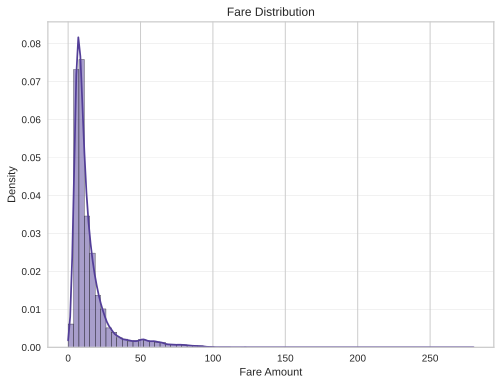

In [76]:
# frequency of fare_amount
plt.figure(figsize=(8, 6))
sns.histplot(con_data_train2['fare_amount'], bins = 75, color ='#533e98' , stat='density', kde=True)
plt.title('Fare Distribution');
plt.xlabel('Fare Amount');
plt.grid(axis='y', lw = 0.25);
# plt.savefig('plot1.png', dpi = 300, bbox_inches = 'tight');

In [77]:
#create new variable log of fare amount
con_data_train2["log_fare_amount"] = np.log(con_data_train2["fare_amount"])

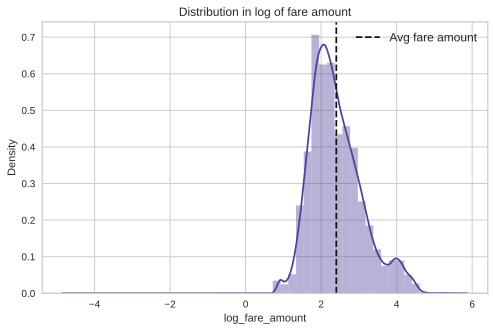

In [78]:
plt.figure(figsize = (8,5))
sns.distplot(con_data_train2["log_fare_amount"],color ='#533e98')
plt.axvline(con_data_train2["log_fare_amount"].mean(),color = "k",
            linestyle = "dashed",label = "Avg fare amount")
plt.title("Distribution in log of fare amount")
plt.legend(loc = "best",prop = {"size" : 12});
# plt.savefig('plot2.png', dpi = 300, bbox_inches = 'tight');

In [79]:
fig1=plt.figure(figsize=(8, 6))
ax1=fig1.add_subplot(1,1,1)
ax1.scatter(con_data_train2.trip_distance, con_data_train2.fare_amount, color='#533e98',alpha=0.1)
ax1.set_title('The graph of payment depending on the trip distance')
ax1.set_xlabel('Distance')
ax1.set_ylabel('Payment');

fig2= plt.figure(figsize=(8, 6))
ax2= fig2.add_subplot(1,1,1)
ax2.scatter(con_data_train2.passenger_count, con_data_train2.fare_amount, color='#c15a3a',alpha=0.1)
ax2.set_title('The graph of payment depending on the number of passengers');
ax2.set_xlabel('Number of passengers')
ax2.set_ylabel('Payment');
# plt.savefig('plot3.png', dpi = 300, bbox_inches = 'tight');

In [80]:
con_data_train2['passenger_count'].value_counts()

1.0    40947
2.0     2840
5.0      724
3.0      409
6.0      398
4.0      144
Name: passenger_count, dtype: int64

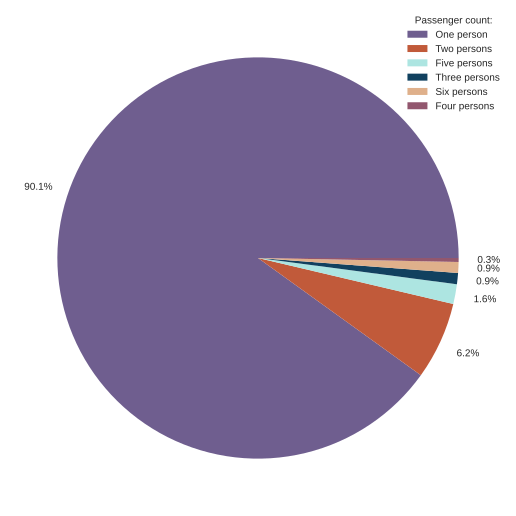

In [81]:
# passenger count in trips distribution
plt.figure(figsize=(9, 19))
pass_count = con_data_train2['passenger_count'].value_counts()
c = ['#6f5e8f', '#c15a3a', '#ade5e1', '#11415f', '#dfb08b', '#92576e']
plt.pie(pass_count,labels=None
        , autopct="%0.1f%%", pctdistance=1.15, colors=c);
plt.legend(title = 'Passenger count:',
           labels=['One person', 'Two persons','Five persons', 'Three persons', 'Six persons','Four persons']);
# plt.savefig('plot4.png', dpi = 300, bbox_inches = 'tight');

<Figure size 576x432 with 0 Axes>

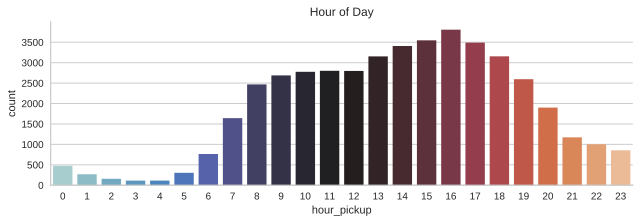

In [82]:
# taxi trip repartition by hour of the day
plt.figure(figsize=(8,6));
sns.catplot(x='hour_pickup', kind='count', palette='icefire', data=con_data_train2, height=3, aspect=3);
plt.title('Hour of Day');
# plt.savefig('plot5.png', dpi = 300, bbox_inches = 'tight');

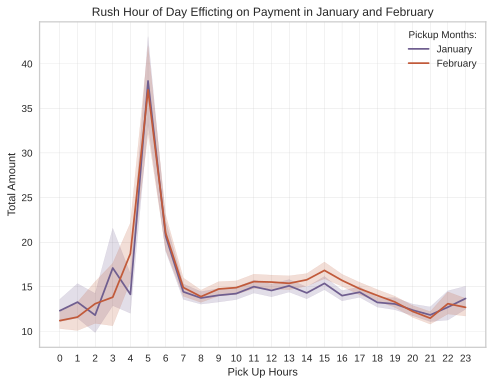

In [83]:
plt.figure(figsize=(8,6));
sns.lineplot(data = con_data_train2, x='hour_pickup',y='fare_amount',palette=['#6f5e8f', '#c15a3a'], hue='month_pickup')
plt.xticks(np.arange(0, 24, 1))
plt.legend(title = 'Pickup Months:',
           labels=['January', 'February']);
plt.xlabel('Pick Up Hours')
plt.ylabel('Total Amount')
plt.title('Rush Hour of Day Efficting on Payment in January and February');
plt.grid(axis='both', lw = 0.25);
# plt.savefig('plot6.png', dpi = 300, bbox_inches = 'tight');

1. Does the number of passengers affect the fare?

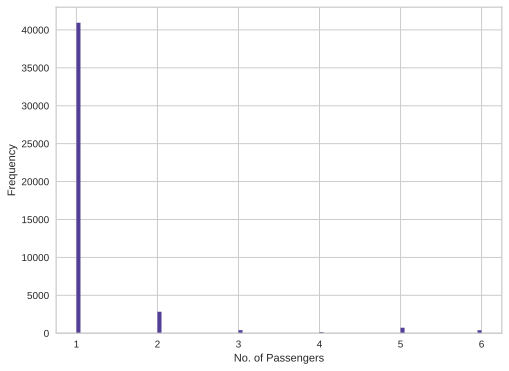

In [84]:
plt.figure(figsize=(8,6))
plt.hist(con_data_train2['passenger_count'], bins=100, color='#533e98' )
plt.xlabel('No. of Passengers')
plt.ylabel('Frequency');
# plt.savefig('plot7.png', dpi = 300, bbox_inches = 'tight');

In [85]:
plt.figure(figsize=(8,6))
plt.scatter(x=con_data_train2['passenger_count'], y=con_data_train2['fare_amount'], s=10, color='#c15a3a',alpha=0.2)
plt.xlabel('No. of Passengers')
plt.ylabel('Fare');
# plt.savefig('plot8.png', dpi = 300, bbox_inches = 'tight');

2. Does the time of pickup affect the fare?

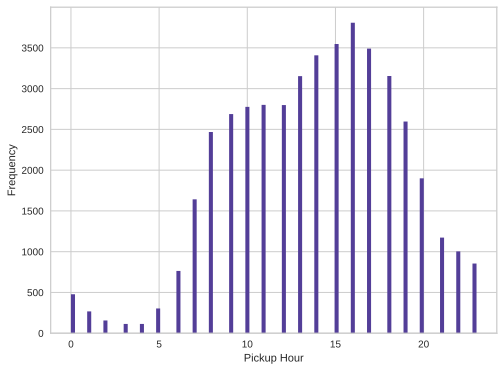

In [86]:
plt.figure(figsize=(8,6))
plt.hist(con_data_train2['hour_pickup'], bins=100, color='#533e98')
plt.xlabel('Pickup Hour')
plt.ylabel('Frequency');
# plt.savefig('plot9.png', dpi = 300, bbox_inches = 'tight');

In [87]:
plt.figure(figsize=(8,6))
plt.scatter(x=con_data_train2['hour_pickup'], y=con_data_train2['fare_amount'], s=10, color='#c15a3a',alpha=0.2)
plt.xlabel('Pickup Hour')
plt.ylabel('Fare');
# plt.savefig('plot10.png', dpi = 300, bbox_inches = 'tight');

3. Does the day of the week affect the fare?

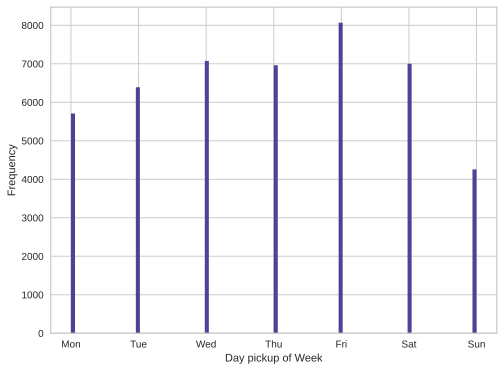

In [88]:
plt.figure(figsize=(8,6))
positions = (0, 1, 2, 3, 4, 5, 6)
labels = ('Mon','Tue','Wed','Thu','Fri','Sat','Sun')
plt.xticks(positions,labels); 
plt.hist(con_data_train2['week_day_pickup'], bins=100, color='#533e98')
plt.xlabel('Day pickup of Week')
plt.ylabel('Frequency');
# plt.savefig('plot11.png', dpi = 300, bbox_inches = 'tight');

 day of the week doesn't seem to have that much of an influence on the number of cab rides.

In [89]:
plt.figure(figsize=(8,6))
positions = (0, 1, 2, 3, 4, 5, 6)
labels = ('Mon','Tue','Wed','Thu','Fri','Sat','Sun')
plt.xticks(positions,labels); 
plt.scatter(x=con_data_train2['week_day_pickup'], y=con_data_train2['fare_amount'], s=10, color='#c15a3a',alpha=0.2)
plt.xlabel('Day pickup of Week')
plt.ylabel('Fare');
# plt.savefig('plot12.png', dpi = 300, bbox_inches = 'tight');

---
## Relation Between Features

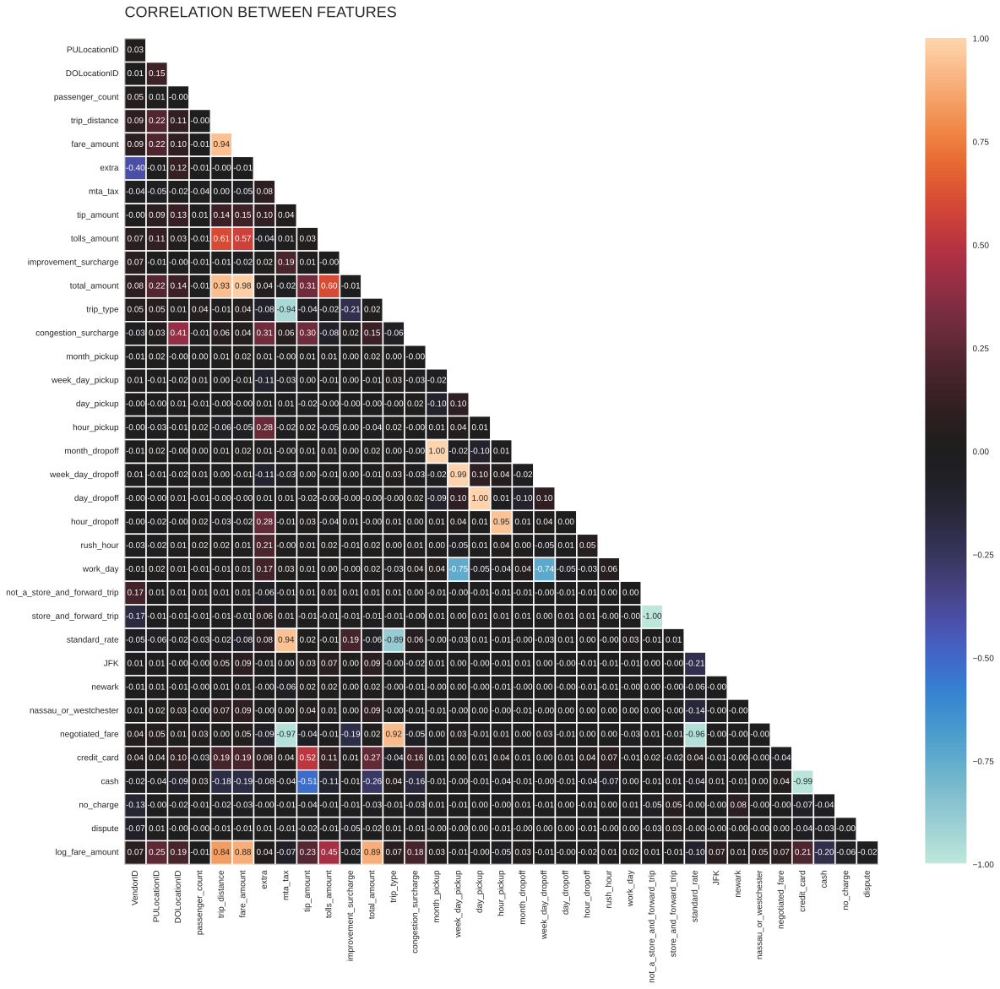

In [90]:
plt.rcParams["figure.figsize"] = (20,18);

# corr
con_data_corr = con_data_train2.corr()

# mask
mask = np.triu(np.ones_like(con_data_corr, dtype=np.bool))

# adjust mask and df
mask = mask[1:, :-1]
corr = con_data_corr.iloc[1:,:-1].copy()

sns.heatmap(corr, cmap = 'icefire', annot = True, vmin= -1, vmax= 1, linewidths=1.5, fmt='.2f', mask=mask);
plt.title('CORRELATION BETWEEN FEATURES\n', loc='left', fontsize=18);
# plt.savefig('plot13.png', dpi = 300, bbox_inches = 'tight');

In [91]:
con_data_corr = con_data_train2.corr()['fare_amount'][:-1] 
corr_features = con_data_corr[abs(con_data_corr) > 0.5].sort_values(ascending=False)
print('Strongly correlated features with fare amount:\n{}'.format(corr_features))

Strongly correlated features with fare amount:
fare_amount      1.000000
total_amount     0.982011
trip_distance    0.943636
tolls_amount     0.567995
Name: fare_amount, dtype: float64


---
## Scaling
scaling the features makes interpretation of regression coefficients easier

In [92]:
con_data_val.shape

(11421, 35)

In [93]:
con_data_train2.shape

(45462, 36)

In [94]:
con_data_test.shape

(14157, 35)

In [95]:
scaler = StandardScaler()

train_sample[train_sample.columns]=scaler.fit_transform(train_sample[train_sample.columns])
val_sample[val_sample.columns]=scaler.transform(val_sample[val_sample.columns])
test_sample[test_sample.columns]=scaler.transform(test_sample[test_sample.columns])



In [96]:
X_train=train_sample
y_train=con_data_train2['fare_amount']
X_val=val_sample
y_val=con_data_val['fare_amount']
X_test=test_sample
y_test=con_data_test['fare_amount']

In [117]:
print("Length of the X_train = ",len(X_train))
print("Length of the y_train = ",len(y_train))
print("Length of the X_test = ",len(X_test))
print("Length of the y_test = ",len(y_test))
print("Length of the y_val = ",len(X_val))
print("Length of the y_val = ",len(y_val))

Length of the X_train =  45462
Length of the y_train =  45462
Length of the X_test =  14157
Length of the y_test =  14157
Length of the y_val =  11421
Length of the y_val =  11421


---
## Model Building

In [98]:
seed = 199
lm = LinearRegression()
lm1 = lm.fit(X_train,y_train)
y_pred_val = lm1.predict(X_val)
y_pred_train = lm1.predict(X_train)
y_pred_test = lm1.predict(X_test)
print("R-sq of training set = ",lm1.score(X_train,y_train))
print("R-sq of validation set = ",lm1.score(X_val,y_val))
print("R-sq of Test set = ",lm1.score(X_test,y_test))

R-sq of training set =  0.8958784302743414
R-sq of validation set =  0.8873632219361898
R-sq of Test set =  0.8199823782820791


In [118]:
# plot
pred = lm1.predict(X_train) 
sns.jointplot(x= pred, y= y_train, kind='reg', color='#533e98');
# plt.savefig('plot14.png', dpi = 300, bbox_inches = 'tight');

In [100]:
from sklearn import metrics
print('\nLinear Regression Performance Metrics')
print('R^2=',metrics.explained_variance_score(y_test,y_pred_test))
print('MAE:',metrics.mean_absolute_error(y_test,y_pred_test))
print('MSE:',metrics.mean_squared_error(y_test,y_pred_test))
print('RMSE:',np.sqrt(metrics.mean_squared_error(y_test,y_pred_test)))


Linear Regression Performance Metrics
R^2= 0.8199852158088357
MAE: 2.0607542111700248
MSE: 38.18410187450748
RMSE: 6.1793285941522385


In [101]:
visualizer = prediction_error(lm, X_train, y_train, X_test, y_test, size=(700, 400),color='y')
# plt.savefig('plot15.png', dpi = 300, bbox_inches = 'tight');

---
## Ridge Regularization

In [102]:
#  train data
lm_model_ridge = Ridge(alpha = .01)
lm_model_ridge.fit(X_train, y_train)
lm_model_ridge.score(X_train, y_train)

0.8958841761098928

In [103]:
#  val data 
lm_model_ridge = Ridge(alpha = 0.01)
lm_model_ridge.fit(X_train, y_train)
lm_model_ridge.score(X_val, y_val)

0.8873714297229044

In [104]:
#  Test data 
lm_model_ridge = Ridge(alpha = 0.01)
lm_model_ridge.fit(X_train, y_train)
lm_model_ridge.score(X_test, y_test)

0.8199560330816885

In [105]:
#Mean Absolute Error (MAE)
def mae(y_true, y_pred):
    return np.mean(np.abs(y_pred - y_true)) 

In [106]:
alphalist = 10**(np.linspace(-2,2,200))
err_vec_val = np.zeros(len(alphalist))
err_vec_train = np.zeros(len(alphalist))

for i,curr_alpha in enumerate(alphalist):

    
    steps = [('standardize', StandardScaler()), 
             ('Ridge', Ridge(alpha = curr_alpha))]

    pipe = Pipeline(steps)
    pipe.fit(X_train.loc[:,:].values, y_train)
    
    val_set_pred = pipe.predict(X_val.loc[:,:].values)
    err_vec_val[i] = mae(y_val, val_set_pred)

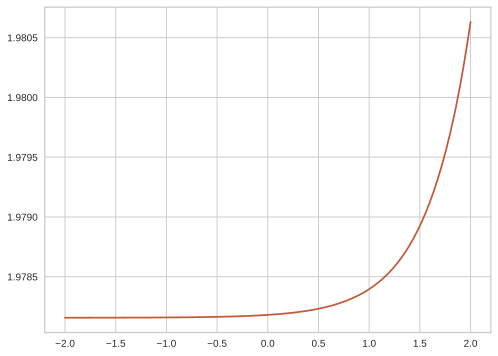

In [107]:
plt.figure(figsize=(8,6))
plt.plot(np.log10(alphalist), err_vec_val, color='#c15a3a');
# plt.savefig('plot16.png', dpi = 300, bbox_inches = 'tight');

In [108]:
np.min(err_vec_val)

1.9781568910167266

In [109]:
alphalist[np.argmin(err_vec_val)]

0.01

---
## Lasso Model

In [110]:
# train  
lm_model_lasso = Lasso(alpha = 0.01)
lm_model_lasso.fit(X_train, y_train)
lm_model_lasso.score(X_train, y_train)

0.8958747622803688

In [111]:
# val  
lm_model_lasso = Lasso(alpha = 0.01)
lm_model_lasso.fit(X_train, y_train)
lm_model_lasso.score(X_val, y_val)

0.8873352612583593

In [112]:
#  Test data 
lm_model_ridge = Ridge(alpha = 0.01)
lm_model_ridge.fit(X_train, y_train)
lm_model_ridge.score(X_test, y_test)

0.8199560330816885

In [113]:
alphalist = 10**(np.linspace(-2,2,200))
er_vec_val = np.zeros(len(alphalist))
er_vec_train = np.zeros(len(alphalist))

for i,curr_alpha in enumerate(alphalist):

    
    steps = [('standardize', StandardScaler()), 
             ('Lasso', Lasso(alpha = curr_alpha))]

    pipe = Pipeline(steps)
    pipe.fit(X_train.loc[:,:].values, y_train)
    
    val_set_pred = pipe.predict(X_val.loc[:,:].values)
    er_vec_val[i] = mae(y_val, val_set_pred)

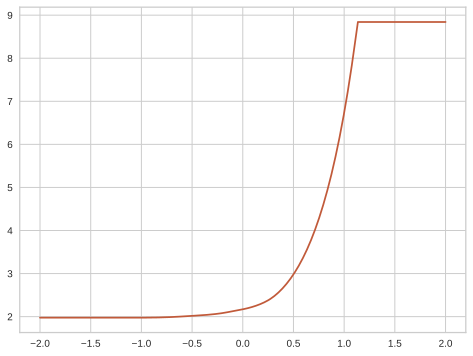

In [114]:
plt.figure(figsize=(8,6))
plt.plot(np.log10(alphalist), er_vec_val, color='#c15a3a');
# plt.savefig('plot17.png', dpi = 300, bbox_inches = 'tight');

In [115]:
np.min(er_vec_val)

1.9740183702970722

In [116]:
alphalist[np.argmin(err_vec_val)]

0.01